## Business Problem:

As a data analyst, you have been tasked with developing a predictive model that can accurately forecast the popularity of a given song based on its underlying audio features. This task holds significant potential for music industry professionals, including record label executives, music producers, and artists, who are constantly seeking innovative ways to leverage data-driven insights and optimize their creative and promotional strategies. By accurately identifying the key audio features that are most influential in predicting song popularity, this model can aid music professionals in crafting successful new compositions and implementing more effective marketing campaigns.

## Data:

**To gain access to Spotify API follow these steps**:

Go to this link (https://developer.spotify.com/dashboard) -> Log into Spotify -> Create an app -> Click settings -> View client secret -> Copy and paste the codes into the "cid and secret"

This code gathers data on music tracks from the Spotify API using the Spotipy library.

The code starts by searching for tracks released in the year 2023 and retrieving their artist name, track name, popularity, and track ID. This data is stored in separate lists.

Then, the track IDs are used to retrieve additional data on the audio features of each track, including danceability, energy, and loudness, using the sp.audio_features() function provided by the Spotipy library. The results are stored in a list called rows.

Once both sets of data have been collected, they are merged into a single Pandas dataframe using the pd.merge() function. The resulting dataset contains information on the artist name, track name, popularity, track ID, and various audio features for each track released in the year 2023 that were found in the Spotify API.

## Analysis Performed:

Data Cleaning and Preprocessing Tasks: Data preprocessing functions that are used to clean and prepare data before it is fed into a machine learning model. The clean_data(df) function cleans the dataset by imputing missing values, removing duplicates, inconsistent rows, and invalid values. The non_scale_clean_data(df) function performs the same cleaning process as clean_data(df) but does not scale the numerical columns. The preprocess_data(df) function applies Isolation Forest to remove outliers, scales the numerical columns, and one-hot encodes the categorical columns. The select_features(X, y) function performs feature scaling and one-hot encoding for categorical features.

Comparing Three Song Popularity Prediction Models: The first model is a linear regression model that predicts the popularity of a song based on its features, such as danceability, energy, and tempo. It uses Ridge regression to perform hyperparameter tuning and evaluates the model using mean squared error and R^2.

The second model is a binary classification model that predicts whether a song is popular or not based on its features. It preprocesses the data using a pipeline that includes scaling numerical features and one-hot encoding categorical features, performs feature selection using a Random Forest Classifier, and handles data imbalance using SMOTE. It then uses logistic regression as the classification algorithm, tunes hyperparameters using GridSearchCV, and evaluates performance using cross-validation and accuracy score.

The third model uses Auto-sklearn to automatically select the best classification algorithm and hyperparameters for predicting whether a song is popular or not based on its features. It preprocesses the data by scaling numerical features and one-hot encoding categorical features and uses cross-validation to find the best model.

Analyzing Model Performance: The evaluation of a model's performance using the Receiver Operating Characteristic (ROC) curve, which plots the true positive rate (TPR) against the false positive rate (FPR) for different threshold values. The area under the ROC curve (AUC) is calculated as a measure of the model's discriminatory power. The permutation importance is then computed to identify the most important features contributing to the model's performance. Finally, the weights of each feature and the summary statistics of the model are printed, and the leaderboard and the details of each model's performance are displayed.


## Limitations: 

Due to the inability of my computer to run the autosklearn model, I had to access the Bash shell in Windows Subsystem for Linux (WSL) by following the procedures outlined in https://www.wikihow.com/Install-Linux.

Limitations of this dataset include its limited scope, which only contains a specific set of features related to each track, such as popularity, danceability, energy, and so on. Other important information, such as lyrics, release date, or album name, is not included. Additionally, the knowledge cutoff for this dataset is September 2021, so any tracks released after that time will not be included. Moreover, this dataset does not cover tracks from earlier decades, which may be relevant in certain analyses.

Another limitation is that the dataset may be biased towards certain genres or artists due to factors such as popularity or market trends. This can limit the generalizability of any conclusions drawn from this dataset. Additionally, the analysis is constrained by the dataset, which only encompasses top-rated popular songs, thereby limiting the scope of the study to exclude undiscovered songs.

### Import needed Libaries

In [48]:
import logging
import numpy as np
import pandas as pd
from imblearn.over_sampling import SMOTE
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier, IsolationForest
from sklearn.feature_selection import SelectFromModel
from sklearn.impute import KNNImputer
from sklearn.linear_model import LogisticRegression, LinearRegression, Ridge
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, mean_squared_error, r2_score, roc_curve, auc, roc_auc_score
from sklearn.model_selection import cross_val_score, GridSearchCV, train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
import autosklearn.classification
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
import ydata_profiling

## **Follow steps in the Data Section for cid and secret**

In [49]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials

cid ="xx" 
secret = "xx"

client_credentials_manager = SpotifyClientCredentials(client_id=cid, client_secret=secret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

In [50]:
# create a function to retrieve tracks
import timeit
def retrieve_tracks(year, limit):
    offset = 0
    results = []
    while True:
        track_results = sp.search(q=f'year:{year}', type='track', limit=50, offset=offset)
        items = track_results['tracks']['items']
        results.extend(items)
        offset += len(items)
        if len(items) < 50 or offset >= limit:
            break
    return results

start = timeit.default_timer()

# retrieve tracks for year 2023, limit of 1000
tracks = retrieve_tracks(year=2023, limit=1000)

# extract relevant information and store in lists
artist_name = [track['artists'][0]['name'] for track in tracks]
track_name = [track['name'] for track in tracks]
track_id = [track['id'] for track in tracks]
popularity = [track['popularity'] for track in tracks]

stop = timeit.default_timer()
print('Time to run this code (in seconds):', stop - start)

[WARNING] [2023-04-10 13:03:37,512:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:37,723:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:38,210:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:38,264:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:38,552:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:38,606:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:38,920:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:38,975:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:39,263:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:39,316:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:39,644:spotipy.cache_handler] Co

In [51]:
print('number of elements in the track_id list:', len(track_id))

number of elements in the track_id list: 1000


In [52]:
df_tracks = pd.DataFrame({'artist_name':artist_name,'track_name':track_name,'track_id':track_id,'popularity':popularity})
print(df_tracks.shape)
df_tracks.head()

(1000, 4)


,artist_name,track_name,track_id,popularity
0,PinkPantheress,Boy's a liar Pt. 2,6AQbmUe0Qwf5PZnt4HmTXv,97
1,Miley Cyrus,Flowers,0yLdNVWF3Srea0uzk55zFn,100
2,Morgan Wallen,Last Night,59uQI0PADDKeE6UZDTJEe8,89
3,Morgan Wallen,Last Night,7K3BhSpAxZBznislvUMVtn,88
4,Morgan Wallen,Thinkin’ Bout Me,0PAcdVzhPO4gq1Iym9ESnK,86


In [54]:
# again measuring the time
start = timeit.default_timer()

# empty list, batchsize and the counter for None results
rows = []
batchsize = 100
None_counter = 0

for i in range(0,len(df_tracks['track_id']),batchsize):
    batch = df_tracks['track_id'][i:i+batchsize]
    feature_results = sp.audio_features(batch)
    for i, t in enumerate(feature_results):
        if t == None:
            None_counter = None_counter + 1
        else:
            rows.append(t)
            
print('Number of tracks where no audio features were available:',None_counter)

stop = timeit.default_timer()
print ('Time to run this code (in seconds):',stop - start)

[WARNING] [2023-04-10 13:03:45,014:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:45,070:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:45,321:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:45,371:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:45,615:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:45,681:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:45,914:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:45,983:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:46,210:spotipy.cache_handler] Couldn't read cache at: .cache
[WARNING] [2023-04-10 13:03:46,270:spotipy.cache_handler] Couldn't write token to cache at: .cache
[WARNING] [2023-04-10 13:03:46,530:spotipy.cache_handler] Co

In [55]:
df_audio_features = pd.DataFrame.from_dict(rows,orient='columns')
print("Shape of the dataset:", df_audio_features.shape)
df_audio_features.head()

Shape of the dataset: (998, 18)


,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature
0,0.696,0.809,5,-8.254,1,0.0500,0.2520,0.000128,0.2480,0.857,132.962,audio_features,6AQbmUe0Qwf5PZnt4HmTXv,spotify:track:6AQbmUe0Qwf5PZnt4HmTXv,https://api.spotify.com/v1/tracks/6AQbmUe0Qwf5...,https://api.spotify.com/v1/audio-analysis/6AQb...,131013,4
1,0.707,0.681,0,-4.325,1,0.0668,0.0632,0.000005,0.0322,0.646,117.999,audio_features,0yLdNVWF3Srea0uzk55zFn,spotify:track:0yLdNVWF3Srea0uzk55zFn,https://api.spotify.com/v1/tracks/0yLdNVWF3Sre...,https://api.spotify.com/v1/audio-analysis/0yLd...,200455,4
2,0.517,0.675,6,-5.382,1,0.0357,0.4590,0.000000,0.1510,0.518,203.853,audio_features,59uQI0PADDKeE6UZDTJEe8,spotify:track:59uQI0PADDKeE6UZDTJEe8,https://api.spotify.com/v1/tracks/59uQI0PADDKe...,https://api.spotify.com/v1/audio-analysis/59uQ...,163855,4
3,0.492,0.675,6,-5.456,1,0.0389,0.4670,0.000000,0.1420,0.478,203.759,audio_features,7K3BhSpAxZBznislvUMVtn,spotify:track:7K3BhSpAxZBznislvUMVtn,https://api.spotify.com/v1/tracks/7K3BhSpAxZBz...,https://api.spotify.com/v1/audio-analysis/7K3B...,163855,4
4,0.656,0.757,3,-5.775,0,0.0308,0.4920,0.000000,0.1170,0.429,139.971,audio_features,0PAcdVzhPO4gq1Iym9ESnK,spotify:track:0PAcdVzhPO4gq1Iym9ESnK,https://api.spotify.com/v1/tracks/0PAcdVzhPO4g...,https://api.spotify.com/v1/audio-analysis/0PAc...,177388,4


In [56]:
columns_to_drop = ['analysis_url','track_href','type','uri']
df_audio_features.drop(columns_to_drop, axis=1,inplace=True)

df_audio_features.rename(columns={'id': 'track_id'}, inplace=True)

df_audio_features.shape

(998, 14)

In [57]:
# merge both dataframes
# the 'inner' method will make sure that we only keep track IDs present in both datasets
df = pd.merge(df_tracks,df_audio_features,on='track_id',how='inner')
print("Shape of the dataset:", df_audio_features.shape)
df.head()

Shape of the dataset: (998, 14)


,artist_name,track_name,track_id,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,PinkPantheress,Boy's a liar Pt. 2,6AQbmUe0Qwf5PZnt4HmTXv,97,0.696,0.809,5,-8.254,1,0.0500,0.2520,0.000128,0.2480,0.857,132.962,131013,4
1,Miley Cyrus,Flowers,0yLdNVWF3Srea0uzk55zFn,100,0.707,0.681,0,-4.325,1,0.0668,0.0632,0.000005,0.0322,0.646,117.999,200455,4
2,Morgan Wallen,Last Night,59uQI0PADDKeE6UZDTJEe8,89,0.517,0.675,6,-5.382,1,0.0357,0.4590,0.000000,0.1510,0.518,203.853,163855,4
3,Morgan Wallen,Last Night,7K3BhSpAxZBznislvUMVtn,88,0.492,0.675,6,-5.456,1,0.0389,0.4670,0.000000,0.1420,0.478,203.759,163855,4
4,Morgan Wallen,Thinkin’ Bout Me,0PAcdVzhPO4gq1Iym9ESnK,86,0.656,0.757,3,-5.775,0,0.0308,0.4920,0.000000,0.1170,0.429,139.971,177388,4


In [58]:
# Save the modified DataFrame to a CSV file
df.to_csv('spotifyfeatures2023v04.csv', index=False)

In [59]:
report = ydata_profiling.ProfileReport(df, title="Pandas Profiling Report")
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

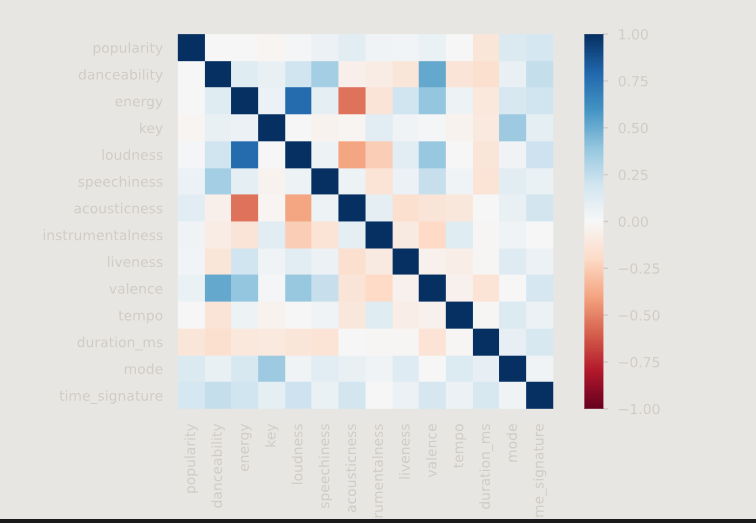

In [60]:
df.describe()

,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000,998.000000
mean,32.168337,0.638227,0.651112,5.225451,-6.371672,0.529058,0.095876,0.236224,0.015087,0.182434,0.474137,121.593969,206397.752505,3.951904
std,37.144405,0.142282,0.186641,3.612954,2.821479,0.499405,0.094535,0.268231,0.079293,0.129081,0.228448,28.028740,48050.199661,0.289730
min,0.000000,0.206000,0.056200,0.000000,-23.023000,0.000000,0.023200,0.000146,0.000000,0.032200,0.038500,40.319000,28428.000000,3.000000
25%,0.000000,0.546000,0.543250,2.000000,-7.664000,0.000000,0.037500,0.037000,0.000000,0.095525,0.304000,99.994000,177270.250000,4.000000
50%,2.000000,0.655500,0.676500,5.000000,-5.848000,1.000000,0.056000,0.115000,0.000002,0.128000,0.468000,121.961000,201354.500000,4.000000
75%,75.000000,0.737000,0.796000,8.000000,-4.424000,1.000000,0.105500,0.349000,0.000113,0.237000,0.647000,141.013500,229627.000000,4.000000
max,100.000000,0.957000,0.965000,11.000000,-0.484000,1.000000,0.564000,0.985000,0.922000,0.844000,0.961000,205.432000,588139.000000,5.000000


In [61]:
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)



def impute_missing_values(df):
    """Fill missing values using KNN imputation."""
    imputer = KNNImputer(n_neighbors=5)
    return pd.DataFrame(imputer.fit_transform(df), columns=df.columns)

def remove_duplicates(df):
    """Remove any duplicate rows."""
    num_duplicates = df.duplicated().sum()
    df.drop_duplicates(inplace=True)
    print(f"Removed {num_duplicates} duplicate rows.")
    return df

def remove_inconsistent_rows(df):
    """Remove any inconsistent rows."""
    #three standard deviations (mean +- (3 * STD))
    popularity_filter = (df['popularity'] >= 0.195220 - (3 * 1.015686)) & (df['popularity'] <= 0.195220 + (3 * 1.015686))
    energy_filter = (df['energy'] >= -0.040686 - (3 * 0.951108)) & (df['energy'] <= -0.040686 + (3 * 0.951108))
    duration_filter = (df['duration_ms'] >=  -0.064580 - (3 * 0.898885) ) & (df['duration_ms'] <= -0.064580 + (3 *  0.898885))
    num_inconsistent = len(df) - len(df.loc[popularity_filter & energy_filter & duration_filter])
    df = df.loc[popularity_filter & energy_filter & duration_filter]
    print(f"Removed {num_inconsistent} inconsistent rows.")
    return df

def remove_invalid_values(df):
    """Check for invalid values and remove the corresponding rows."""
    invalid_row_filter = pd.to_numeric(df['popularity'], errors='coerce').isna()
    if any(invalid_row_filter):
        invalid_row_count = invalid_row_filter.sum()
        df = df.loc[~invalid_row_filter]
        print(f"Removed {invalid_row_count} row(s) with invalid value(s).")
    return df

def non_scale_remove_inconsistent_rows(df):
    """Remove any inconsistent rows."""
    popularity_filter = (df['popularity'] >= 0) & (df['popularity'] <= 100)
    energy_filter = (df['energy'] >= 0) & (df['energy'] <= 1)
    duration_filter = (df['duration_ms'] >= 0) & (df['duration_ms'] <= 600000)
    num_inconsistent = len(df) - len(df.loc[popularity_filter & energy_filter & duration_filter])
    df = df.loc[popularity_filter & energy_filter & duration_filter]
    print(f"Removed {num_inconsistent} inconsistent rows.")
    return df

def clean_data(df):
    """Clean the dataset by imputing missing values, removing duplicates, inconsistent rows, and invalid values."""
    df = impute_missing_values(df)
    df = remove_duplicates(df)
    df = remove_inconsistent_rows(df)
    df = remove_invalid_values(df)
    return df

def non_scale_clean_data(df):
    """Clean the dataset by imputing missing values, removing duplicates, inconsistent rows, and invalid values."""
    df = impute_missing_values(df)
    df = remove_duplicates(df)
    df = non_scale_remove_inconsistent_rows(df)
    df = remove_invalid_values(df)
    return df

def preprocess_data(df):
    """Preprocess the dataset by removing outliers, scaling numerical features, and one-hot encoding categorical features."""
    # Separate the numerical and categorical columns
    numerical_cols = ['popularity', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms']
    categorical_cols = ['key', 'mode', 'time_signature']

    # Identify and remove outliers using Isolation Forest algorithm
    clf = IsolationForest(n_estimators=100, contamination=0.05, random_state=42)
    df['outlier'] = clf.fit_predict(df[numerical_cols])
    df = df[df['outlier'] == 1].drop('outlier', axis=1)

    # Scale the numerical columns
    scaler = StandardScaler()
    df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

    # One-hot encode the categorical columns
    encoder = OneHotEncoder()
    encoded_cols = []
    for col in categorical_cols:
        encoded_col = encoder.fit_transform(df[[col]]).toarray()
        n_values = encoded_col.shape[1]
        col_names = [f"{col}_{i}" for i in range(n_values)]
        df[col_names] = encoded_col
        encoded_cols.extend(col_names)
    df = df.drop(categorical_cols, axis=1)

     # Check if "time_signature" column exists in the DataFrame
    if "time_signature" in df.columns:
        # Convert "time_signature" column to integer type
        df["time_signature"] = df["time_signature"].astype(int)


    # Clean the dataset by imputing missing values, removing duplicates, inconsistent rows, and invalid values
    df = clean_data(df)

    return df


def select_features(X, y):
    # Feature scaling and one-hot encoding for categorical features
    preprocessor = ColumnTransformer(transformers=[
        ('num', StandardScaler(), X.select_dtypes(include=np.number).columns),
        ('cat', OneHotEncoder(handle_unknown='ignore'), X.select_dtypes(include=object).columns)
    ])
    X = preprocessor.fit_transform(X)
    
    # Feature selection using a Random Forest Classifier
    clf = RandomForestClassifier(n_estimators=100, random_state=42)
    selector = SelectFromModel(clf)
    X = selector.fit_transform(X, y)
    
    return X, y

### LOGISTIC REGRESSION

In [62]:
# Load the data
spotify_df1 = pd.read_csv('spotifyfeatures2023v04.csv')

spotify_df1 = spotify_df1.drop(['track_name', 'track_id','artist_name'], axis=1)

# Preprocess the data
spotify_df1 = preprocess_data(spotify_df1)

spotify_df1['duration_ms'].describe()

# separate the features and target variable
X = spotify_df1.drop(['popularity'], axis=1)
y = spotify_df1['popularity']


# split the data into training, validation, and testing sets
X_trainval, X_test, y_trainval, y_test = train_test_split(X, y, test_size=0.4, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_trainval, y_trainval, test_size=0.5, random_state=42)

# create the linear regression model and fit it to the training data
lr = LinearRegression()
lr.fit(X_train, y_train)

# perform cross-validation to find optimal hyperparameters
# here, we vary the regularization parameter alpha and use 5-fold cross-validation
alphas = [0.001, 0.01, 0.1, 1, 10]
cv_scores = []
for alpha in alphas:
    ridge = Ridge(alpha=alpha)
    scores = -cross_val_score(ridge, X_trainval, y_trainval, cv=5, scoring='neg_mean_squared_error')
    cv_scores.append(scores.mean())
optimal_alpha = alphas[cv_scores.index(min(cv_scores))]

# retrain the model with optimal hyperparameters using both the training and validation sets
ridge = Ridge(alpha=optimal_alpha)
ridge.fit(X_trainval, y_trainval)

# evaluate the model on the testing set
y_pred = ridge.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('Mean Squared Error:', mse)
print('R^2:', r2)

Removed 173 duplicate rows.
Removed 17 inconsistent rows.
Mean Squared Error: 0.962113062937113
R^2: 0.0645853847564527


/home/scott/.local/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


### Classification Model

In [79]:
# Load data
data1 = df

# Split into features and target
X = data1.drop(['popularity'], axis=1)
y = data1['popularity'].apply(lambda x: 1 if x > 1.190157 else 0)

# Preprocessing pipeline
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), X.select_dtypes(include=np.number).columns),
    ('cat', OneHotEncoder(handle_unknown='ignore'), X.select_dtypes(include=object).columns)
])
X_preprocessed = preprocessor.fit_transform(X)


# Feature selection using a Random Forest Classifier
X_selected, y = select_features(X, y)


# Handle data imbalance using SMOTE
oversample = SMOTE()
X_resampled, y_resampled = oversample.fit_resample(X_selected, y)

# Try Logistic Regression as an alternative algorithm
model = LogisticRegression(random_state=42, max_iter=1000)
param_grid = {'C': [0.01, 0.1, 1, 10]}
grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1, scoring='accuracy')
grid_search.fit(X_resampled, y_resampled)
model = grid_search.best_estimator_

# Evaluate performance using cross-validation
scores = cross_val_score(model, X_resampled, y_resampled, cv=5, scoring='accuracy')
print('Cross-validation scores:', scores)
print('Mean accuracy:', np.mean(scores))

# Evaluate performance on testing set
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on testing set: {:.2f}%".format(accuracy * 100))


Cross-validation scores: [0.78341014 0.79262673 0.70833333 0.66203704 0.8287037 ]
Mean accuracy: 0.7550221880867043
Accuracy on testing set: 86.18%


In [64]:
# Load the data
Scaled_df1 = pd.read_csv('spotifyfeatures2023v04.csv')

Scaled_df1 = preprocess_data(Scaled_df1.drop(['track_name', 'track_id','artist_name'], axis=1))

Scaled_df1.describe()

Removed 173 duplicate rows.
Removed 17 inconsistent rows.


/home/scott/.local/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


,popularity,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,...,key_7,key_8,key_9,key_10,key_11,mode_0,mode_1,time_signature_0,time_signature_1,time_signature_2
count,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,...,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000,758.000000
mean,0.195220,0.040052,-0.040686,-0.025121,0.047757,0.031731,-0.011913,-0.012605,0.021278,-0.003372,...,0.102902,0.076517,0.077836,0.044855,0.097625,0.449868,0.550132,0.071240,0.914248,0.014512
std,1.015686,1.013521,0.951108,0.961295,1.024353,0.984303,1.003060,1.009090,1.000854,1.034064,...,0.304032,0.265999,0.268091,0.207122,0.297003,0.497809,0.497809,0.257395,0.280182,0.119667
min,-0.855759,-3.187398,-2.757992,-3.691287,-0.769914,-0.864562,-0.207790,-1.194396,-1.983555,-2.147700,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-0.828839,-0.627373,-0.659277,-0.537223,-0.603192,-0.699477,-0.207790,-0.678862,-0.746704,-0.832818,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.234499,0.136080,0.060530,0.116481,-0.405958,-0.372045,-0.207749,-0.421905,0.007418,-0.043832,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000
75%,1.190157,0.770164,0.722521,0.646873,0.203177,0.479859,-0.205132,0.356260,0.761541,0.743577,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000
max,1.836235,2.286136,1.734298,2.406498,4.316751,2.951384,9.958407,5.385962,2.120742,3.019289,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [65]:
Scaled_df1['duration_ms'].describe()

count    758.000000
mean      -0.064580
std        0.898885
min       -2.676101
25%       -0.641892
50%       -0.116462
75%        0.481821
max        2.500583
Name: duration_ms, dtype: float64

In [66]:
Scaled_df1.columns

Index(['popularity', 'danceability', 'energy', 'loudness', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'duration_ms', 'key_0', 'key_1', 'key_2', 'key_3', 'key_4', 'key_5',
       'key_6', 'key_7', 'key_8', 'key_9', 'key_10', 'key_11', 'mode_0',
       'mode_1', 'time_signature_0', 'time_signature_1', 'time_signature_2'],
      dtype='object')

In [67]:
# Load the data

Non_Scale_data1 = pd.read_csv('spotifyfeatures2023v04.csv')

Non_Scale_data1 = non_scale_clean_data(Non_Scale_data1.drop(['track_name', 'track_id','artist_name'], axis=1))

Non_Scale_data1.describe()

Removed 177 duplicate rows.
Removed 0 inconsistent rows.


,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000,821.000000
mean,38.969549,0.639764,0.641998,5.135201,-6.478495,0.548112,0.100601,0.245340,0.015266,0.181883,0.473063,121.526676,206687.836784,3.947625
std,37.533956,0.145194,0.179986,3.638546,2.794170,0.497983,0.097780,0.265665,0.081852,0.130706,0.229622,28.921098,50531.145410,0.297854
min,0.000000,0.206000,0.056200,0.000000,-23.023000,0.000000,0.023200,0.000146,0.000000,0.032200,0.038500,40.319000,28428.000000,3.000000
25%,1.000000,0.539000,0.538000,2.000000,-7.664000,0.000000,0.038500,0.042800,0.000000,0.096700,0.297000,98.194000,177507.000000,4.000000
50%,41.000000,0.657000,0.666000,5.000000,-5.941000,1.000000,0.057700,0.131000,0.000002,0.126000,0.468000,120.020000,200787.000000,4.000000
75%,76.000000,0.743000,0.782000,8.000000,-4.695000,1.000000,0.114000,0.378000,0.000116,0.230000,0.643000,141.889000,229805.000000,4.000000
max,100.000000,0.957000,0.965000,11.000000,-0.484000,1.000000,0.564000,0.985000,0.922000,0.844000,0.961000,205.432000,588139.000000,5.000000


In [68]:
Non_Scale_data1.columns

Index(['popularity', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'duration_ms', 'time_signature'],
      dtype='object')

### Primary Model (Scaled AutoSklearn Model)

In [69]:
# Define the features and target variable
#(Ensure that the binary cutoff for binary variable is the 75% cutoff of popularity) 
features = ['danceability', 'energy', 'loudness', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'duration_ms', 'key_0', 'key_1', 'key_2', 'key_3', 'key_4', 'key_5',
       'key_6', 'key_7', 'key_8', 'key_9', 'key_10', 'key_11', 'mode_0',
       'mode_1', 'time_signature_0', 'time_signature_1', 'time_signature_2']

Scaled_df1['target'] = Scaled_df1['popularity'].apply(lambda x: 1 if x > 1.190157 else 0)

# Split the data into training and testing sets
train, test = train_test_split(Scaled_df1, test_size=0.33, random_state=1)

# Split the training and testing sets into features and target variables
X_train = train[features]
y_train = train['target']
X_test = test[features]
y_test = test['target']

# Create an Auto-sklearn classification model
scaled_model = autosklearn.classification.AutoSklearnClassifier(time_left_for_this_task=5*60,
                                                        per_run_time_limit=30,
                                                        n_jobs=6,
                                                        metric=autosklearn.metrics.roc_auc,
                                                                   )

# Find cross-validation accuracy scores
cv_accuracy_scores = cross_val_score(scaled_model, X_train, y_train, cv=5)

# Print the cross-validation accuracy scores
print("Cross-validation accuracy scores:", cv_accuracy_scores)

# Find the mean and standard deviation of cross-validation accuracy scores
mean_cv_accuracy = np.mean(cv_accuracy_scores)
std_cv_accuracy = np.std(cv_accuracy_scores)

# Fit the model to the training data
scaled_model.fit(X_train, y_train)

# Score the model
predictions = scaled_model.predict_proba(X_test)

# Calculate the model's performance metrics
roc_auc = roc_auc_score(y_test, predictions[:, 1])
precision = precision_score(y_test, predictions[:, 1].round(), average='binary', zero_division=1)
recall = recall_score(y_test, predictions[:, 1].round(), average='binary')
f1 = f1_score(y_test, predictions[:, 1].round(), average='binary')

# Print the model's performance metrics
print(f"Auto-Sklearn Classifier performance metrics: ROC AUC = {roc_auc:.2f}, Precision = {precision:.2f}, Recall = {recall:.2f}, F1 Score = {f1:.2f}")


Cross-validation accuracy scores: [0.56983806 0.56831984 0.60026316 0.52815789 0.57538462]
[WARNING] [2023-04-10 13:29:06,655:Client-EnsembleBuilder] No models better than random - using Dummy losses!
	Models besides current dummy model: 0
	Dummy models: 1
[WARNING] [2023-04-10 13:29:06,778:Client-EnsembleBuilder] No models better than random - using Dummy losses!
	Models besides current dummy model: 0
	Dummy models: 1
Auto-Sklearn Classifier performance metrics: ROC AUC = 0.66, Precision = 0.40, Recall = 0.23, F1 Score = 0.29


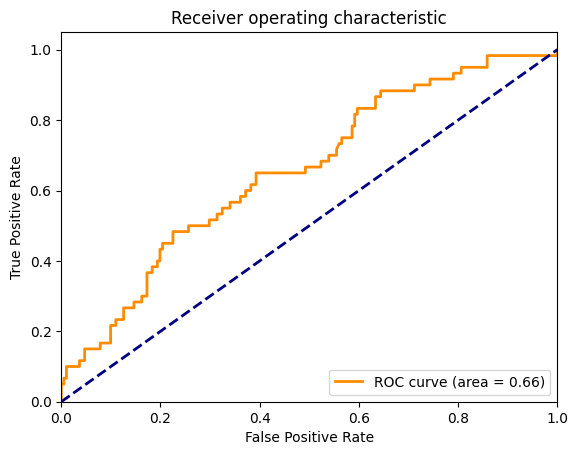

In [70]:
%matplotlib inline
# Calculate the fpr and tpr for all thresholds of the model
fpr, tpr, thresholds = roc_curve(y_test, predictions[:, 1])
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='darkorange', lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

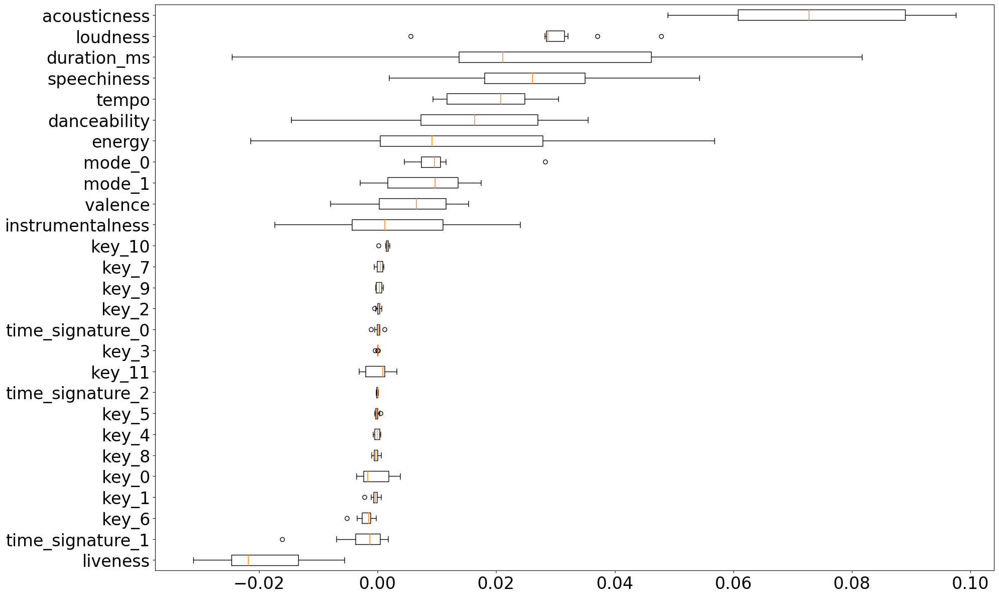

In [71]:
r = permutation_importance(
    scaled_model, X_test, y_test,
    n_repeats=10, random_state=0, n_jobs=4,
    scoring='roc_auc',
)

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(111)
sort_idx = r.importances_mean.argsort()
ax.boxplot(r.importances[sort_idx].T, labels=[X_test.columns[i] for i in sort_idx], vert=False)
for label in ax.get_xticklabels() + ax.get_yticklabels():
    label.set_fontsize(24)
fig.tight_layout()

plt.savefig('FeatureImportance_roc_auc.png')

## Conclusion:

The ROC curve plot illustrates the model's ability to differentiate between positive and negative classes, and the AUC score measures its overall performance. A higher AUC value indicates better performance. In this case, the ROC curve has an AUC of 0.66, indicating the model's moderate performance in distinguishing between popular and unpopular songs. Moreover, the plot displays a trade-off between the true positive rate (TPR) and false positive rate (FPR), implying that the model can achieve different TPR and FPR levels depending on the selected threshold.

Further analysis indicates that the top three critical factors for determining the popularity of a song are acousticness, loudness, and duration_ms, while liveness is the least influential and may introduce noise to certain models.

In [72]:
# Get the weights of each feature
weights = scaled_model.get_models_with_weights()
    
# Print the weights of each layer
print(weights)

[(0.28, SimpleClassificationPipeline({'balancing:strategy': 'none', 'classifier:__choice__': 'gradient_boosting', 'data_preprocessor:__choice__': 'feature_type', 'feature_preprocessor:__choice__': 'polynomial', 'classifier:gradient_boosting:early_stop': 'train', 'classifier:gradient_boosting:l2_regularization': 1.3692488379612932e-08, 'classifier:gradient_boosting:learning_rate': 0.8288685061585398, 'classifier:gradient_boosting:loss': 'auto', 'classifier:gradient_boosting:max_bins': 255, 'classifier:gradient_boosting:max_depth': 'None', 'classifier:gradient_boosting:max_leaf_nodes': 20, 'classifier:gradient_boosting:min_samples_leaf': 28, 'classifier:gradient_boosting:scoring': 'loss', 'classifier:gradient_boosting:tol': 1e-07, 'data_preprocessor:feature_type:numerical_transformer:imputation:strategy': 'most_frequent', 'data_preprocessor:feature_type:numerical_transformer:rescaling:__choice__': 'minmax', 'feature_preprocessor:polynomial:degree': 2, 'feature_preprocessor:polynomial:inc

In [73]:
# summarize
print(scaled_model.sprint_statistics())

auto-sklearn results:
  Dataset name: 2e8c8efe-d7c5-11ed-803d-00155d73b8cb
  Metric: roc_auc
  Best validation score: 0.702003
  Number of target algorithm runs: 169
  Number of successful target algorithm runs: 152
  Number of crashed target algorithm runs: 13
  Number of target algorithms that exceeded the time limit: 4
  Number of target algorithms that exceeded the memory limit: 0



In [74]:
scaled_model.leaderboard()

,rank,ensemble_weight,type,cost,duration
model_id,,,,,
91,1,0.08,gradient_boosting,0.297997,19.332773
145,2,0.10,gradient_boosting,0.298564,3.993547
148,3,0.04,gradient_boosting,0.302721,3.276362
16,4,0.16,gradient_boosting,0.304044,3.787258
159,5,0.02,gradient_boosting,0.305367,4.559798
142,6,0.08,gradient_boosting,0.310280,3.938094
141,7,0.02,gradient_boosting,0.316327,2.423466
119,8,0.02,gradient_boosting,0.319728,18.579422
65,9,0.02,gradient_boosting,0.322940,1.031392


In [75]:
print(scaled_model.show_models())

{16: {'model_id': 16, 'rank': 1, 'cost': 0.30404383975812554, 'ensemble_weight': 0.16, 'data_preprocessor': <autosklearn.pipeline.components.data_preprocessing.DataPreprocessorChoice object at 0x7f3cde445600>, 'balancing': Balancing(random_state=1), 'feature_preprocessor': <autosklearn.pipeline.components.feature_preprocessing.FeaturePreprocessorChoice object at 0x7f3cff6c99f0>, 'classifier': <autosklearn.pipeline.components.classification.ClassifierChoice object at 0x7f3cff6c9270>, 'sklearn_classifier': HistGradientBoostingClassifier(early_stopping=True,
                               l2_regularization=2.3302874783091707e-08,
                               learning_rate=0.20076124721016717, loss='auto',
                               max_iter=512, max_leaf_nodes=419,
                               min_samples_leaf=29, n_iter_no_change=18,
                               random_state=1, validation_fraction=None,
                               warm_start=True)}, 20: {'model_id': 20, 'ran

### produces execessive results so uncomment when you need information on models.

In [76]:
# # For compatibility with scikit-learn we implement `cv_results_`
# print(scaled_model.cv_results_)